In [1]:
from IPython.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))
dpath = '/home/dprotter/testmount/Protter/cohort_2_pfc_screening/dwp/7364/2024_08_27/10_50_20/com_check/My_V4_Miniscope/'

# Preface

## about this document

Welcome to the main pipeline of minian!
The purpose of this annotated version of the minian pipeline is to guide the user through each step of the code, working with a short demo movie.
The intention is to enable the user to understand the code as much as possible so that they are equipped with the knowledge necessary to customize the code for their own needs, regardless of prior programming skills.

Before we start, it s highly recommended that you get familiar with basic python concepts and operations like [string manipulation](https://docs.python.org/3/library/string.html), [tuples, lists and dictionaries](https://docs.python.org/3/tutorial/datastructures.html).

The notes in this pipeline are supposed to give you minimal amount of knowledge to walkthrough the pipeline and touch on parameters that are most commonly tweaked.
The [Minian readthedocs](https://minian.readthedocs.io) site contains more comprehensive documentations.
In particular, the [API reference](https://minian.readthedocs.io/page/api/index.html) contains detailed documentation of every minian function.
Be sure to check them out whenever you are puzzled by how to specify parameters!

## text styling

Note on the styling of this document: most of the sentences should hopefully make sense if taken literally.
However, some special formatting of the text is used to demonstrate the close relationship between the concepts discussed and the code, as well as encouraging the reader to understand the Python syntax.
Specifically:

-  a [hyperlink](https://en.wikipedia.org/wiki/Hyperlink) usually points to a well-defined python module, class or methods, especially when that concept is first encountered in this document.
    The link usually points to the official documentation of that concept, which in some cases might not be the best place to start for a beginner.
    If you find the documentation puzzling, try to google the concept in question and find a tutorial that best suits you.
-  an inline `code` usually refers to a name that already exsists in the [namespace](https://docs.python.org/3/tutorial/classes.html#python-scopes-and-namespaces) (i.e. the context where we run the codes in this document).
    It can be a previously encountered concept, but more often it referes to variable names or method names that we [imported](https://docs.python.org/3/reference/import.html) or have defined along the way.
-  **bold** texts are used more loosely to highlight anything that requires more attention.
    Though they are not used as carefully as previous formats, they often refer to specific values that a variable or method arguments can assume.
-  <div class="alert alert-info">
    
    Info boxes are used to provide hints and tips to help users run through this pipeline smoothly.
    </div>

## workflow

There are 5 main sections in this pipeline: Setting up, Pre-processing, Motion Correction, Initialization, and CNMF, which are composed of interative spatial update and temporal update.

![workflow](img/workflow.png)

# Setting Up

The cells under this section should be executed every time the kernel is restarted.

## load modules

Loads the minian modules, usually this cell should not be modified.

In [2]:
%%capture
%load_ext autoreload
%autoreload 2
import itertools as itt
import os
import sys

import holoviews as hv
import numpy as np
import xarray as xr
from dask.distributed import Client, LocalCluster
from holoviews.operation.datashader import datashade, regrid
from holoviews.util import Dynamic
from IPython.core.display import display

## set path and parameters

Set all of the parameters that control the notebook’s behavior.
Ideally, the following cell is the only part of the code the user will have to change when analyzing different datasets.
Here we briefly introduce only some of the initial parameters that are necessary to start the pipeline, and leave the discussion of specific parameters for later.

* `minian_path` is the path that contains the **minian** folder , where the minian codebase (.py files) reside.
    The default value `"."` means “current folder”, which should work in most cases, unless you want to try out another version of minian that is not in the same folder as this notebook.

* `dpath` is the folder that contains the videos to be processed.

* `interactive` controls whether interactive plots will be shown for parameters exploration.
    Interactive plotting requires CPU/memory usage, and thus could require some time (in particular, those steps where video is played).
    In principle, the user might want to visualize interactive plots during the initial parameters exploration, once the parameters are set and ready for batch processing, the user will set interactive as False to reduce processing time.

* `output_size` controls the relative size of all the plots on a scale of 0-100 percent, though it can be set to values >100 without any problem. 

* `param_save_minian` specifies the destination folder and format of the saved data.
    `dpath` is the folder path  where  the data will be saved.
    `meta_dict` is a `dictionary` that is used to construct meta data for the final labeled data structure.
    `overwrite` is a boolean value controlling whether the data is overwritten if a file already exists.
    We set it to `True` here so you can easily play with the demo multiple times, but **use caution** with this option during actual analysis.
    In addition to erasing prior data that may be important to you, overwritting data may cause compatibility issues with existing data from the same minian dataset folder.
    If you want to re-analyze a video from scratch using different parameters, it is recommended that you delete existing data first.

<div class="alert alert-info">
<strong>folder structure</strong>

The defult `meta_dict` in `param_save_minian` assumes output minian datasets are stored in heirarchiically arranged folders, as shown below:

```
mice1  
│
└───session1
│   │
│   └───minian
│       │   Y.zarr
│       │   A.zarr
│       │   ...
│   
└───session2
    │
    └───minian
```

The default value can be read as follows:
The name of the last folder (`-1`) in `dpath` (the folder that directly contains the videos) will be used to designate the value of a metadata dimension named `"session"`.
The name of the second-to-last folder (`-2`) in `dpath` will be used to designate the value for `"animal"` and so on.
Both the keys (name of metadata dimension) and values (numbers indicating which level of folder name should be used) of `meta_dict` can be modified to represent your preferred way of data storage. 
Note that the metadata are determined by the folder structure of saved minian datasets, not by those of input movie data.
</div>

In [3]:
# Set up Initial Basic Parameters#
minian_path = "."

minian_ds_path = os.path.join(dpath, "minian")
intpath = os.path.join(dpath,'minian_intermediate_2')
subset = dict(frame=slice(0, None))
subset_mc = None
interactive = True
output_size = 100
output_modifier = 0.4
n_workers = min([int(os.getenv("MINIAN_NWORKERS", 12)), 10])
param_save_minian = {
    "dpath": minian_ds_path,
    "meta_dict": dict(session=-1, animal=-2),
    "overwrite": True,
}

# Pre-processing Parameters#
param_load_videos = {
    "pattern": ".avi$",
    "dtype": np.uint8,
    "downsample": dict(frame=1,height=1,width=1),
    "downsample_strategy": "subset",
}
param_denoise = {"method": "median", "ksize": 7}
param_background_removal = {"method": "tophat", "wnd": 15}

# Motion Correction Parameters#
subset_mc = None
param_estimate_motion = {"dim": "frame"}

# Initialization Parameters#
param_seeds_init = {
    "wnd_size": 1000,
    "method": "rolling",
    "stp_size": 500,
    "max_wnd": 15,
    "diff_thres": 3,
}
param_pnr_refine = {"noise_freq": 0.06, "thres": 1}
param_ks_refine = {"sig": 0.05}
param_seeds_merge = {"thres_dist": 10, "thres_corr": 0.8, "noise_freq": 0.06}
param_initialize = {"thres_corr": 0.8, "wnd": 10, "noise_freq": 0.06}
param_init_merge = {"thres_corr": 0.8}

# CNMF Parameters#
param_get_noise = {"noise_range": (0.06, 0.5)}
param_first_spatial = {
    "dl_wnd": 10,
    "sparse_penal": 0.01,
    "size_thres": (25, None),
}
param_first_temporal = {
    "noise_freq": 0.06,
    "sparse_penal": 1,
    "p": 1,
    "add_lag": 20,
    "jac_thres": 0.2,
}
param_first_merge = {"thres_corr": 0.8}
param_second_spatial = {
    "dl_wnd": 10,
    "sparse_penal": 0.01,
    "size_thres": (25, None),
}
param_second_temporal = {
    "noise_freq": 0.06,
    "sparse_penal": 1,
    "p": 1,
    "add_lag": 20,
    "jac_thres": 0.4,
}

os.environ["OMP_NUM_THREADS"] = "1"
os.environ["MKL_NUM_THREADS"] = "1"
os.environ["OPENBLAS_NUM_THREADS"] = "1"
os.environ["MINIAN_INTERMEDIATE"] = intpath

## import minian

The following cell loads **minian** and usually should not be modified. If you encounter an `ImportError`, check that you followed the installation instructions and that `minian_path` is pointing to the right place.

In [4]:
%%capture
sys.path.append(minian_path)
from minian.cnmf import (
    compute_AtC,
    compute_trace,
    get_noise_fft,
    smooth_sig,
    unit_merge,
    update_spatial,
    update_temporal,
    update_background,
)
from minian.initialization import (
    gmm_refine,
    initA,
    initC,
    intensity_refine,
    ks_refine,
    pnr_refine,
    seeds_init,
    seeds_merge,
)
from minian.motion_correction import apply_transform, estimate_motion
from minian.preprocessing import denoise, remove_background
from minian.utilities import (
    TaskAnnotation,
    get_optimal_chk,
    load_videos,
    open_minian,
    save_minian,
)
from minian.visualization import (
    CNMFViewer,
    VArrayViewer,
    generate_videos,
    visualize_gmm_fit,
    visualize_motion,
    visualize_preprocess,
    visualize_seeds,
    visualize_spatial_update,
    visualize_temporal_update,
    write_video,
)

ModuleNotFoundError: No module named 'minian'

## module initialization

The following cell handles initialization of modules and parameters necessary for minian to be run and usually should not be modified.

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
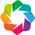

In [5]:
dpath = os.path.abspath(dpath)
hv.notebook_extension("bokeh", width=100)

## start cluster

In [6]:
#phil said in talk to decrease memory limit as much as you can, but increase
#number of workers instead. suggested no lower than 2GB. so I dunno, i did 5 cause I have 
#a lot. Once you have 'enough' memory, increasing doesnt improve performance. but increasing
#workers might. workers should be no more than 1 / computer core. I have 12 cores, 
#so i guess I could go up to 12. I set the default to 10 (os.getenv("MINIAN_WORKERS", 10)) 
#sets the default to 10 if not defined in the env.

cluster = LocalCluster(
    n_workers=n_workers,
    memory_limit="10GB",
    resources={"MEM": 1},
    threads_per_worker=2,
    dashboard_address=":8787",
)
annt_plugin = TaskAnnotation()
cluster.scheduler.add_plugin(annt_plugin)
client = Client(cluster)

/home/dprotter/anaconda3/envs/minian_dwp/lib/python3.8/site-packages/distributed/node.py:182: UserWarning: Port 8787 is already in use.
Perhaps you already have a cluster running?
Hosting the HTTP server on port 41581 instead
  warnings.warn(


NameError: name 'TaskAnnotation' is not defined

# Pre-processing

In the pre-processing steps that follow, the pipeline will load and process the videos  (downsampling, subsetting, denoising).

All functions are evaluated lazily, which means that initially only a “plan” for the actual computation will be created, without its execution. Actual computations are carried out only when results are being saved

## loading videos and visualization

Recall the values of `param_load_videos`:

In [7]:
param_load_videos

{'pattern': '.avi$',
 'dtype': numpy.uint8,
 'downsample': {'frame': 1, 'height': 1, 'width': 1},
 'downsample_strategy': 'subset'}

The first argument of load_videos should be the path that contains the videos(`dpath`).
We then pass the dictionary, `param_load_videos`, defined earlier, which specifies several relevant arguments.
The argument `pattern` is optional and is the [regular expression](https://docs.python.org/3/library/re.html) used to filter files under the specified folder.
The default value `r"msCam[0-9]+\.avi$"` means that a file can only be loaded if its filename contains **'msCam'**, followed by at least one number, then **'.avi'** as the end of the filename.
This can be changed to suit the naming convention of your videos.
The resulting "video array" `varr` contains three dimensions: `height`, `width`, and `frame`.
If you wish to downsample the video, pass in a dictionary to `downsample`, with the name of dimensions as keys and  the downsampling folds as integer value.
For example, `downsample=dict("frame"=2)` will temporally downsample the video with a factor of 2.
`downsample_strategy` will assume two values: either `"subset"`, meaning downsampling are carried out simply by subsetting the data, or `"mean"`, meaning a mean will be calculated on the window of downsampling (the latter being slower).

In addition to the video array `varr`, the following cell also try to estimate best chunk size `chk` to use for computations.
This variable is needed for later steps since it's important to keep chunk size consistent within the pipeline.
If for some reason you have to restart the kernel at some point, remember to either note down the content of `chk` or rerun the following cell.

<div class="alert alert-info">
<strong>changing parameters</strong>

All minian parameters are `dict` and you can freely change them in various ways.
You can go back to the initial parameter setting cell and change things there.
Alternatively, you can add a code cell before running the relevant step.
For example, the following line will tell the function to load from `"/my/data_path"`:
```python
param_load_videos["vapth"] = "/my/data_path"
```
While the following line will change the downsample setting (which is specified as a `dict` on its own) when loading the video:
```python
param_load_videos["downsample"] = {"frame": 2}
```
</div>

In [8]:
interactive = True

In [9]:

varr = load_videos(dpath, **param_load_videos)
#varr = varr.sel(frame = slice(61, None))
chk, _ = get_optimal_chk(varr, dtype=float)




video list is: ['/home/dprotter/testmount/Protter/cohort_2_pfc_screening/dwp/7364/2024_08_27/10_50_20/com_check/My_V4_Miniscope/0.avi', '/home/dprotter/testmount/Protter/cohort_2_pfc_screening/dwp/7364/2024_08_27/10_50_20/com_check/My_V4_Miniscope/1.avi', '/home/dprotter/testmount/Protter/cohort_2_pfc_screening/dwp/7364/2024_08_27/10_50_20/com_check/My_V4_Miniscope/2.avi', '/home/dprotter/testmount/Protter/cohort_2_pfc_screening/dwp/7364/2024_08_27/10_50_20/com_check/My_V4_Miniscope/3.avi', '/home/dprotter/testmount/Protter/cohort_2_pfc_screening/dwp/7364/2024_08_27/10_50_20/com_check/My_V4_Miniscope/4.avi', '/home/dprotter/testmount/Protter/cohort_2_pfc_screening/dwp/7364/2024_08_27/10_50_20/com_check/My_V4_Miniscope/5.avi']
loading 6 videos in folder /home/dprotter/testmount/Protter/cohort_2_pfc_screening/dwp/7364/2024_08_27/10_50_20/com_check/My_V4_Miniscope


In [10]:
varr

<xarray.DataArray 'fluorescence' (frame: 5963, height: 600, width: 600)>
dask.array<concatenate, shape=(5963, 600, 600), dtype=uint8, chunksize=(1000, 600, 600), chunktype=numpy.ndarray>
Coordinates:
  * frame    (frame) int64 0 1 2 3 4 5 6 ... 5956 5957 5958 5959 5960 5961 5962
  * height   (height) int64 0 1 2 3 4 5 6 7 ... 592 593 594 595 596 597 598 599
  * width    (width) int64 0 1 2 3 4 5 6 7 8 ... 592 593 594 595 596 597 598 599

We then immediately save the array representation to the intermediate folder to avoid repeatedly loading the video in later steps.

In [11]:
%%time
varr = save_minian(
    varr.chunk({"frame": chk["frame"], "height": -1, "width": -1}).rename("varr"),
    intpath,
    overwrite=True,
)

CPU times: user 2.66 s, sys: 641 ms, total: 3.3 s
Wall time: 37.3 s


The variable `varr` is a [xarray.DataArray](http://xarray.pydata.org/en/stable/generated/xarray.DataArray.html#xarray.DataArray).
Now is a perfect time to familiarize yourself with this data structure and the [xarray](https://xarray.pydata.org/en/stable/) module in general, since we will be using these data structures throughout the analysis.
Basically, a `xarray.DataArray` is N-dimensional array labeled with additional metadata, with many useful properties that make them easy to manipulate.
We can ask the computer to print out some information of `varr` by calling it (as with any other variable):

In [12]:
varr

<xarray.DataArray 'varr' (frame: 5963, height: 600, width: 600)>
dask.array<from-zarr, shape=(5963, 600, 600), dtype=uint8, chunksize=(50, 600, 600), chunktype=numpy.ndarray>
Coordinates:
  * frame    (frame) int64 0 1 2 3 4 5 6 ... 5956 5957 5958 5959 5960 5961 5962
  * height   (height) int64 0 1 2 3 4 5 6 7 ... 592 593 594 595 596 597 598 599
  * width    (width) int64 0 1 2 3 4 5 6 7 8 ... 592 593 594 595 596 597 598 599

We can see now that `varr` is a `xarray.DataArray` with a [name](https://xarray.pydata.org/en/stable/generated/xarray.DataArray.name.html#xarray.DataArray.name) `"demo_movies"` and three dimensions: `frame`, `height` and `width`.
Each dimension is labeled with ascending natural numbers.
The [dtype](https://xarray.pydata.org/en/stable/generated/xarray.DataArray.dtype.html#xarray.DataArray.dtype) ([data type](https://docs.scipy.org/doc/numpy-1.14.0/user/basics.types.html)) of `varr` is `numpy.uint8`.

## visualize raw data and optionally set roi for motion correction

Once the data is loaded we can visualize the content of `varr` with the help of `VArrayViewer`, which shows the array as a movie.
You can also plot summary traces like mean fluorescence across `frames` by passing a `list` of names of traces as inputs.
Currently `"mean"`, `"min"`, `"max"` and `"diff"` are supported, where `"diff"` is mean fluorescent value difference across all pixels in a frame.

`VArrayViewer` also supports a box drawing tool where you can draw a box in the field of view (FOV) and save it as a mask using the `“save mask”` button.
The mask is saved as `vaviewer.mask`, and can be retrieved and used at later stages, for example, when you want to run motion correction on a sub-region of the FOV.
See the [API reference](https://minian.readthedocs.io/page/api/minian.visualization.html#minian-visualization-VArrayViewer) for more detail.

In [13]:
hv.output(size=output_size)
if interactive:
    vaviewer = VArrayViewer(varr, framerate=5, summary=["mean", "max"])
    display(vaviewer.show())

computing summary


Column
    [0] WidgetBox
        [0] Button(button_type='primary', height=30, name='Update Mask', sizing_mode='fixed', width=100)
        [1] Player(end=5962, height=90, interval=10, sizing_mode='fixed', width=650)
    [1] HoloViews(Layout)

If you decide to set a mask for motion correction, the following cell is an example of how to convert the mask into a `subset_mc` parameter that can be later passed into motion correction functions.

In [14]:
if interactive:
    try:
        subset_mc = list(vaviewer.mask.values())[0]
    except IndexError:
        pass

In [15]:
subset_mc

In [16]:
if not subset_mc:
    subset_mc = {'height': slice(63.51875000000004, 526.71875, None),
                 'width': slice(82.68124999999998, 547.08125, None)}

## subset part of video

Before proceeding to pre-processing, it’s good practice to check if there is anything obviously wrong with the video (e.g. the camera suddenly dropped, resulting in dark frames).
This can usually be observed by visualizing the video and plotting the timecourse of the mean fluorescence.
We can utilize the [xarray.DataArray.sel](http://xarray.pydata.org/en/stable/generated/xarray.DataArray.sel.html) method and [slice](https://docs.python.org/3/library/functions.html#slice) to subset any part of the data we want.
By default `subset = None` will result in no subsetting.

<div class="alert alert-info">
<strong>subsetting data</strong>

The [xarray.DataArray.sel](http://xarray.pydata.org/en/stable/generated/xarray.DataArray.sel.html) method takes in either a `dict` or keyword arguments.
In both cases you want to specify the dimension names and the coordinates of the subset as key-value pairs.
For example, say you want only the first 800 frames of the video, the following two lines will both work and they are equivalent:
```python
varr.sel(frame=slice(0, 799)) # slice object is inclusive on both ends
varr.sel({"frame": slice(0, 799)})
```
This also works on arbitrary dimensions.
For example, the following will give you a 100px x 100px chunk of your movie at a corner:
```python
varr.sel(height=slice(0, 99), width=slice(0, 99))
```
</div>

In [17]:
varr_ref = varr.sel(subset)

## glow removal and visualization

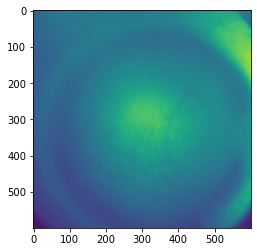

In [18]:
import matplotlib.pyplot as plt
plt.figure()
plt.imshow(varr_ref[1])

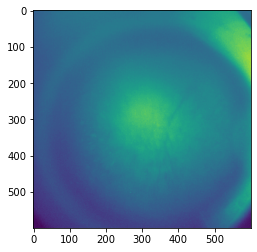

In [19]:
plt.figure()
plt.imshow(varr_ref.min("frame").compute())

Here we remove the general glow background caused by vignetting effect.
We simply calculate a minimum projection across all `frame`s and subtract that projection from all `frame`s.
A benefit of doing this is you could interpret the result as "change of fluorescence from baseline", while preserving the linear scale of the raw data, which is usually the range of a 8-bit integer -- 0-255.
The result can be visualized again with `VArrayViewer`.

In [20]:
import matplotlib.pyplot as plt

In [21]:
hv.Image(varr[-1], ['width', 'height']).opts(cmap='viridis', frame_width = 500, frame_height=500)

:Image   [width,height]   (varr)

In [22]:
%%time
%matplotlib notebook


varr_min = varr_ref.min("frame").compute()
varr_ref = varr_ref - varr_min
'''plt.figure()
plt.imshow(varr_min)'''
hv.Image(varr_min, ['width', 'height']).opts(cmap='viridis', frame_width = 500, frame_height=500)

CPU times: user 291 ms, sys: 34.7 ms, total: 325 ms
Wall time: 621 ms


:Image   [width,height]   (varr)

In [23]:
hv.Image((varr_ref[-1]  - varr_ref[0]) / varr_ref[-1], ['width', 'height']).opts(cmap='viridis', frame_width = 500, frame_height=500)

:Image   [width,height]   (varr)

In [24]:
hv.output(size=int(output_size*0.5 ))
if interactive:
    vaviewer = VArrayViewer(
        [varr.rename("original"), varr_ref.rename("glow_removed")],
        framerate=10,
        summary=None,
        layout=True,
    )
    display(vaviewer.show())

Column
    [0] WidgetBox
        [0] Button(button_type='primary', height=30, name='Update Mask', sizing_mode='fixed', width=100)
        [1] Player(end=5962, height=90, interval=10, sizing_mode='fixed', width=650)
    [1] HoloViews(NdLayout)

In [25]:
hv.Image(varr_min, ['width', 'height']).opts(cmap='viridis', frame_width = 500, frame_height=500)

:Image   [width,height]   (varr)

## denoise

Recall that by default we use a median filter for denoising:

In [26]:
hv.Image(varr_ref.max('frame').compute(), ['width', 'height']).opts(cmap='viridis', frame_width = 500, frame_height=500)

:Image   [width,height]   (varr)

In [27]:
param_denoise

{'method': 'median', 'ksize': 7}

There is only one parameter controlling how the filtering is done: the kernel size (`ksize`) of the filter.
The effect of this parameter can be visualized with the tool below.
Alternatively other methods like gaussian filter, anisotropic filter etc. are implmented as well.
See the [API reference](https://minian.readthedocs.io/page/api/minian.preprocessing.html#minian-preprocessing-denoise) for `denoise` for more detail.

<div class="alert alert-info">

Generally `ksize=5` is good (approximately half the diamater of the largest cell).
Note that if you do want to play with the ksize, it has to be odd number.
</div>

In [28]:
m = varr_ref.max('frame').compute()
hv.output(size=int(output_size * 1))
if interactive:
    display(
        visualize_preprocess(
           m,
            denoise,
            method=["median"],
            ksize=[3,5, 7, 9,11,13],
        )
    )

:Layout
   .Image.Before        :Image   [width,height]   (varr)
   .DynamicMap.Before   :DynamicMap   []
      :RGB   [width,height]   (R,G,B,A)
   .DynamicMap.After.I  :DynamicMap   [method,ksize]
      :Image   [width,height]   (varr_denoised)
   .DynamicMap.After.II :DynamicMap   [method,ksize]
      :RGB   [width,height]   (R,G,B,A)

The following cell would carry out denoise step.
Be sure to [change the parameters](https://minian.readthedocs.io/page/start_guide/faq.html#i-don-t-know-python-can-i-still-use-the-pipeline) based on visualization results before running the following cell.

In [29]:
param_denoise['ksize'] = 3
varr_ref = denoise(varr_ref, **param_denoise)

## background removal

Recall the parameters for background removal:

In [30]:
param_background_removal

{'method': 'tophat', 'wnd': 15}

This step attempts to estimate background (everything except the fluorescent signal of in-focus cells) and subtracts it from the frame.
By default we use a morphological tophat operation to estimate the background from each frame:
First, a [disk element](http://scikit-image.org/docs/dev/api/skimage.morphology.html#disk) with a radius of `wnd` is created.
Then, a [morphological erosion](https://homepages.inf.ed.ac.uk/rbf/HIPR2/erode.htm) using the disk element is applied to each frame, which eats away any bright "features" that are smaller than the disk element.
Subsequently, a [morphological dilation](https://homepages.inf.ed.ac.uk/rbf/HIPR2/dilate.htm) is applied to the "eroded" image, which in theory undoes the erosion except the bright "features" that were completely eaten away.
The overall effect of this process is to remove any bright feature that is smaller than a disk with radius `wnd`.
Thus, when setting `wnd` to the **largest** expected radius of cell, this process can give us a good estimation of the background.
Then finally the estimated background is subtracted from each frame.

<div class="alert alert-info">

Pragmatically `wnd=15` works well.
</div>

In [31]:
hv.output(size=int(output_size * 1))
if interactive:
    display(
        visualize_preprocess(
            varr_ref.max('frame').compute(),
            remove_background,
            method=["tophat"],
            wnd=[5,10, 15, 20],
        )
    )

:Layout
   .Image.Before        :Image   [width,height]   (varr_denoised)
   .DynamicMap.Before   :DynamicMap   []
      :RGB   [width,height]   (R,G,B,A)
   .DynamicMap.After.I  :DynamicMap   [method,wnd]
      :Image   [width,height]   (varr_denoised_subtracted)
   .DynamicMap.After.II :DynamicMap   [method,wnd]
      :RGB   [width,height]   (R,G,B,A)

The following cell would carry out background removal step.
Be sure to [change the parameters](https://minian.readthedocs.io/page/start_guide/faq.html#i-don-t-know-python-can-i-still-use-the-pipeline) based on visualization results before running the following cell.

In [32]:
param_background_removal['wnd'] = 15
varr_ref = remove_background(varr_ref, **param_background_removal)


In [33]:
'''varr_ref = varr_ref.drop_sel(frame = len(varr_ref)-1)
hv.Image(varr_ref[-1], ['width', 'height']).opts(cmap='viridis', frame_width = 500, frame_height=500)'''

"varr_ref = varr_ref.drop_sel(frame = len(varr_ref)-1)\nhv.Image(varr_ref[-1], ['width', 'height']).opts(cmap='viridis', frame_width = 500, frame_height=500)"

## save result

Here we are saving our pre-processed video (`varr_ref`) into the intermediate folder (`intpath`).
Note that for every saved variable a separate folder will be created based on the `.name` attribute of that variable.
And variables with the same `.name` attribute will be saved to same folder regardless the variable name, potentially overwritting each other!
Here we [rename](http://xarray.pydata.org/en/stable/generated/xarray.DataArray.rename.html) it to `"varr_ref"` so that the saved folder will be named "varr_ref.zarr".

In [34]:
%%time
varr_ref = save_minian(varr_ref.rename("varr_ref"), dpath=intpath, overwrite=True)

CPU times: user 1.72 s, sys: 447 ms, total: 2.17 s
Wall time: 21.6 s


# Motion Correction

## estimate motion

Recall the parameters for `estimate_motion`:

In [35]:
param_estimate_motion

{'dim': 'frame'}

By default the motion estimation process is simple: for each pair of frames it calculates a [phase correlation](https://en.wikipedia.org/wiki/Phase_correlation) between the two frames using [fft](https://en.wikipedia.org/wiki/Fast_Fourier_transform).
Then the peak of the phase correlation will correspond to the translational shift between the two frames.
The argument `dim` specifies along which dimension to run the motion estimation, and should always be set to `"frame"` here.
Usually this step is parameter-free, but see [API reference](https://minian.readthedocs.io/page/api/minian.motion_correction.html#minian-motion_correction-estimate_motion) for `estimate_motion` for more advanced tweaking of the parameters.
By default, the results from `estimate_motion` are saved in a two dimensional `DataArray` called `motion`, with two labels on the `shift_dim` dimension, representing the shifts along `"height"` and `"width"` directions.

In [36]:
varr_ref.sel(subset_mc)

<xarray.DataArray 'varr_ref' (frame: 5963, height: 463, width: 465)>
dask.array<getitem, shape=(5963, 463, 465), dtype=uint8, chunksize=(50, 463, 465), chunktype=numpy.ndarray>
Coordinates:
  * frame    (frame) int64 0 1 2 3 4 5 6 ... 5956 5957 5958 5959 5960 5961 5962
  * height   (height) int64 64 65 66 67 68 69 70 ... 520 521 522 523 524 525 526
  * width    (width) int64 83 84 85 86 87 88 89 ... 541 542 543 544 545 546 547

In [37]:
%%time
motion = estimate_motion(varr_ref.sel(subset_mc), **param_estimate_motion)

CPU times: user 393 ms, sys: 23.9 ms, total: 417 ms
Wall time: 406 ms


## save motion

Here is the first time we save a variable to the final output folder using `param_save_minian`:

In [38]:
param_save_minian

{'dpath': '/home/dprotter/testmount/Protter/cohort_2_pfc_screening/dwp/7364/2024_08_27/10_50_20/com_check/My_V4_Miniscope/minian',
 'meta_dict': {'session': -1, 'animal': -2},
 'overwrite': True}

As mentioned before `param_save_minian` decides how your data will be saved and what metadata will be stored.
Additionally we use the `chk` variable earlier to make sure all our data have same chunk size along same dimension.

In [39]:
%%time
motion = save_minian(
    motion.rename("motion").chunk({"frame": chk["frame"]}), **param_save_minian
)

CPU times: user 6.49 s, sys: 1.49 s, total: 7.98 s
Wall time: 1min 13s


## visualization of motion

Here we visualize `motion` as a fluctuating curve across `frame`s.

In [40]:
hv.output(size=output_size)
visualize_motion(motion)

:NdOverlay   [Element]
   :Curve   [frame]   (motion)

## apply transform

After determining each frame's motion, we use the function `apply_transform` to correct for the motion.
Notably, we have to decide what to do with pixels that are shifted from outside of the FOV.
The default is to fill them with 0. 

In [41]:
Y = apply_transform(varr_ref, motion, fill=0)

## save result

Here we save two versions of the motion-corrected movie `Y`.
Their contents are identical.
The only difference is how they are chunked.
Also note that we convert the data to `float` type for better downstream processing.

In [42]:
%%time
Y_fm_chk = save_minian(Y.astype(float).rename("Y_fm_chk"), intpath, overwrite=True)
Y_hw_chk = save_minian(
    Y_fm_chk.rename("Y_hw_chk"),
    intpath,
    overwrite=True,
    chunks={"frame": -1, "height": chk["height"], "width": chk["width"]},
)

CPU times: user 9.78 s, sys: 3.91 s, total: 13.7 s
Wall time: 2min 31s


## visualization of motion-correction

Here we visualize the result of motion correction `Y_fm_chk` side by side with input `varr_ref`.

In [43]:
hv.output(size=int(output_size * output_modifier))
if interactive:
    vaviewer = VArrayViewer(
        [varr_ref.rename("before_mc"), Y_fm_chk.rename("after_mc")],
        framerate=60,
        summary=None,
        layout=True,
    )
    display(vaviewer.show())

Column
    [0] WidgetBox
        [0] Button(button_type='primary', height=30, name='Update Mask', sizing_mode='fixed', width=100)
        [1] Player(end=5962, height=90, interval=10, sizing_mode='fixed', width=650)
    [1] HoloViews(NdLayout)

A potentially better visualization is to look at max projcetion across all frames before and after the motion correction.
You should see that the cells after motion correction have much more defined borders.

In [44]:
max_proj_pre = varr_ref.max("frame").compute().astype(np.float32)
max_proj_img = Y_hw_chk.max("frame").compute()

In [45]:

im_opts = dict(
    frame_width=800,
    aspect=varr_ref.sizes["width"] / varr_ref.sizes["height"],
    cmap="Viridis",
    colorbar=True,
    clim = (8,30)
)
(
    regrid(
        hv.Image(
            max_proj_pre,
            ["width", "height"],
            label="before_mc",
        ).opts(**im_opts)
    )
    + regrid(
        hv.Image(
            max_proj_img.astype(np.float32),
            ["width", "height"],
            label="after_mc",
        ).opts(**im_opts)
    )
)

:Layout
   .DynamicMap.I  :DynamicMap   []
      :Image   [width,height]   (varr_ref)
   .DynamicMap.II :DynamicMap   []
      :Image   [width,height]   (Y_hw_chk)

In [46]:
#vid_arr = xr.concat([varr_ref, Y_fm_chk], "width").chunk({"width": -1})
write_video(Y_fm_chk, "minian_mc.mov", dpath)

'/home/dprotter/testmount/Protter/cohort_2_pfc_screening/dwp/7364/2024_08_27/10_50_20/com_check/My_V4_Miniscope/minian_mc.mov'

## generate video for motion-correction

Finally, we can generate a mp4 video for the original movie and motion-corrected movie side-by-side so that we can play it back at original speed.

In [47]:
temp_varr = varr_ref + 1
df = (temp_varr - np.median(temp_varr.data, axis = 0).compute())/(temp_varr)

hv.output(size=int(output_size * output_modifier))
if interactive:
    vaviewer = VArrayViewer(
        [df.rename("df")],
        framerate=60,
        summary=None,
        layout=True,
    )
    display(vaviewer.show())

Column
    [0] WidgetBox
        [0] Button(button_type='primary', height=30, name='Update Mask', sizing_mode='fixed', width=100)
        [1] Player(end=5962, height=90, interval=10, sizing_mode='fixed', width=650)
    [1] HoloViews(NdLayout)

In [48]:
varr_ref.min().compute()

<xarray.DataArray 'varr_ref' ()>
array(0, dtype=uint8)

In [49]:
max_proj_df = df.max("frame").compute().astype(np.float32)


im_opts = dict(
    frame_width=800,
    aspect=varr_ref.sizes["width"] / varr_ref.sizes["height"],
    cmap="Viridis",
    colorbar=True,
    #clim = (8,15)
)
(
    regrid(
        hv.Image(
            max_proj_img,
            ["width", "height"],
            label="before_mc",
        ).opts(**im_opts)
    )
    + regrid(
        hv.Image(
            max_proj_df.astype(np.float32),
            ["width", "height"],
            label="after_mc",
        ).opts(**im_opts)
    )
)

:Layout
   .DynamicMap.I  :DynamicMap   []
      :Image   [width,height]   (Y_hw_chk)
   .DynamicMap.II :DynamicMap   []
      :Image   [width,height]   (varr_ref)

In [50]:
varr_ref.max().compute()

<xarray.DataArray 'varr_ref' ()>
array(23, dtype=uint8)

In [51]:
plt.figure()
plt.hist(max_proj_img.data.ravel())


<IPython.core.display.Javascript object>

(array([5.18400e+03, 1.70144e+05, 1.60047e+05, 2.31730e+04, 8.14000e+02,
        3.80000e+02, 1.40000e+02, 7.90000e+01, 3.20000e+01, 7.00000e+00]),
 array([ 4. ,  5.8,  7.6,  9.4, 11.2, 13. , 14.8, 16.6, 18.4, 20.2, 22. ]),
 <a list of 10 Patch objects>)

In [52]:
plt.figure()
plt.plot(out)

<IPython.core.display.Javascript object>

NameError: name 'out' is not defined

In [ ]:
plt.figure()
plt.hist(varr_ref[:, 200:300, 400:500].data.ravel())
plt.vlines(x = varr_ref[:, 200:300, 400:500].mean().compute().data, ymin = 0, ymax = 3, color = 'green')
plt.vlines(x = varr_ref[:, 200:300, 400:500].median().compute().data, ymin = 0, ymax = 3, color = 'red')

In [ ]:
max_proj_img.max()

## close cluster

In [ ]:
# client.close()
# cluster.close()